In [1]:
import pandas as pd
import numpy as np
import geojson

import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

## 1. Geographic analysis including neighborhoods of Venezia

In [2]:
neighborhoods_gjson_link = 'data/neighbourhoods.geojson'
listings_link = 'data/listings_cleaned.csv'

### read geojson with neighborhood geo data
with open(neighborhoods_gjson_link) as f:
    neighborhoods_gjson = geojson.load(f)
    
### read listings
listings = pd.read_csv(listings_link)

In [3]:
grouped_by_neighborhoods = listings.groupby('neighbourhood_cleansed').agg({'price' : 'median', 
                                                'availability_30' : 'median', 'review_scores_value' : 'median', 
                                                'host_since_years' : 'median', 'name_touristy' : 'sum',
                                                'id' : 'count'}).reset_index()

grouped_by_neighborhoods.head(2)

,neighbourhood_cleansed,price,availability_30,review_scores_value,host_since_years,name_touristy,id
0,Aeroporto,81.5,21.0,4.675,4.641096,0,4
1,Alberoni,140.0,0.0,4.770,5.076712,0,11


In [4]:
for i in grouped_by_neighborhoods.columns[1:]:
    
    fig = px.choropleth_mapbox(grouped_by_neighborhoods, 
                               geojson = neighborhoods_gjson, featureidkey = 'properties.neighbourhood',
                               locations = 'neighbourhood_cleansed', color = i,
                               color_continuous_scale = 'bluered', # 'armyrose', 'geyser', 'redor', 'temps'
                               mapbox_style = 'carto-positron',
                               zoom = 10, center = {'lat': listings['latitude'].mean(), 
                                                    'lon': listings['longitude'].mean()},
                               opacity = 2/3,
                               labels = {'price' : 'Median prices', 
                                         'availability_30' : 'Median availability<br>in next month',
                                         'review_scores_value' : 'Median rating<br>for a listing',
                                         'host_since_years' : 'Average of hosts<br>active years',
                                         'name_touristy' : 'Number of listings<br>with touristic names',
                                         'id' : 'Number of listings',
                                         'neighbourhood_cleansed' : 'Neighborhood'})
    fig.update_layout(margin={'r' : 0, 't' : 0, 'l' : 0, 'b' : 0})
    fig.show()

Plotting all the listings on a map and coloring by price

In [5]:
listings['size'] = 1

fig = px.scatter_mapbox(listings, lat = 'latitude', lon = 'longitude', hover_name = 'price', 
                        center = {"lat": 45.444617, "lon": 12.321308}, 
                        hover_data = ['name', 'listing_url', 'host_name', 'price', 
                                      'room_type', 'bedrooms', 'review_scores_value'],
                        zoom = 10, color = 'price', size_max = 3, size = 'size', 
                        mapbox_style = 'carto-positron', 
                        color_continuous_scale = 'temps', range_color = [0, 250])
fig.show()

listings.drop('size', 1, inplace = True)

In [6]:
listings.drop(['latitude', 'longitude'], 1, inplace = True)

## 2. Host data analysis 
##### (not vital for modeling, just for interest)

In [7]:
listings['host_join_year'] = pd.to_datetime(listings['host_since']).dt.year
listings['host_join_month'] = pd.to_datetime(listings['host_since']).dt.month
listings['host_join_weekday'] = pd.to_datetime(listings['host_since']).dt.day_name()

listings['host_join_date'] = pd.to_datetime(listings['host_since'])

In [8]:
hosts_by_date = listings.groupby(['host_join_date']).agg({'id' : 'count'}).reset_index().rename(columns = {'host_join_date' : 'date', 'id' : 'number_of_new_hosts'})
hosts_by_date['hosts_registered'] = hosts_by_date['number_of_new_hosts'].cumsum()

fig = px.line(hosts_by_date, 'date', 'hosts_registered',
              title = 'Number of cumulated hosts registered', 
              labels = {'hosts_registered' : 'Number of hosts on site', 'date' : 'Date'},
              width = 700, height = 400)
fig.show()

In [9]:
hosts_by_date_recent = hosts_by_date[hosts_by_date['date'] >= '2019-01-01']

fig = px.line(hosts_by_date_recent, 'date', 'hosts_registered',
              title = 'Number of cumulated hosts registered since 2019', 
              labels = {'hosts_registered' : 'Number of hosts on site', 'date' : 'Date'},
              width = 700, height = 400)
fig.show()

In [10]:
#hosts_by_date[hosts_by_date['number_of_new_hosts'] > hosts_by_date['number_of_new_hosts'].describe(percentiles = [.99])['99%']]

Extract trend, seasonality

In [11]:
hosts_by_ym = listings.groupby(['host_join_year', 'host_join_month']).agg({'id' : 'count'}).reset_index().rename(columns = {'host_join_year' : 'year', 'host_join_month' : 'month', 'id' : 'number_of_new_hosts'})

fig = px.box(hosts_by_ym, x = 'month', y = 'number_of_new_hosts',
              title = 'Hosts joining distribution across months since 2010', 
              labels = {'number_of_new_hosts' : '# of new hosts', 'month' : 'Month'},
              width = 700, height = 400)
fig.show()

In [12]:
hosts_by_ym = listings[listings['host_join_year'] >= 2018].groupby(['host_join_year', 'host_join_month']).agg({'id' : 'count'}).reset_index().rename(columns = {'host_join_year' : 'year', 'host_join_month' : 'month', 'id' : 'number_of_new_hosts'})

fig = px.box(hosts_by_ym, x = 'month', y = 'number_of_new_hosts',
              title = 'Hosts joining distribution across months since 2018', 
              labels = {'number_of_new_hosts' : '# of new hosts', 'month' : 'Month'},
              width = 700, height = 400)
fig.show()

In [13]:
hosts_by_ym = listings.groupby(['host_join_year', 'host_join_month', 'host_join_weekday']).agg({'id' : 'count'}).reset_index().rename(columns = {'host_join_year' : 'year', 'host_join_month' : 'month', 'host_join_weekday' : 'weekday', 'id' : 'number_of_new_hosts'})

fig = px.box(hosts_by_ym, x = 'weekday', y = 'number_of_new_hosts',
              title = 'Hosts joining distribution across weekdays since 2010', 
              labels = {'number_of_new_hosts' : '# of new hosts', 'weekday' : 'Weekday'},
              width = 700, height = 400, range_y = [0, 30])
fig.update_xaxes(categoryorder = 'array', categoryarray= ['Monday','Tuesday','Wednesday','Thursday',
                                                          'Friday', 'Saturday', 'Sunday'])
fig.show()

In [14]:
hosts_by_ym = listings[listings['host_join_year'] >= 2018].groupby(['host_join_year', 'host_join_month', 'host_join_weekday']).agg({'id' : 'count'}).reset_index().rename(columns = {'host_join_year' : 'year', 'host_join_month' : 'month', 'host_join_weekday' : 'weekday', 'id' : 'number_of_new_hosts'})

fig = px.box(hosts_by_ym, x = 'weekday', y = 'number_of_new_hosts',
              title = 'Hosts joining distribution across weekdays since 2018', 
              labels = {'number_of_new_hosts' : '# of new hosts', 'weekday' : 'Weekday'},
              width = 700, height = 400, range_y = [0, 25])
fig.update_xaxes(categoryorder = 'array', categoryarray= ['Monday','Tuesday','Wednesday','Thursday',
                                                          'Friday', 'Saturday', 'Sunday'])
fig.show()


In [15]:
fig = px.box(listings, x = 'host_join_year', y = 'price',
              title = 'Asking price distribution of hosts joining by year', 
              labels = {'host_join_year' : 'Year of joining', 'price' : 'Price'},
              width = 700, height = 400, range_y = [0, 300])
fig.show()

In [16]:
drop_host_features = ['host_url', 'host_name', 'host_since', 'host_join_year', 'host_join_month', 'host_join_date', 'host_join_weekday']
listings.drop(drop_host_features, 1, inplace = True)

## 3. Tabular data analysis

### Price and relationship with other features

Distribution

In [17]:
fig = px.histogram(listings, x = 'price', title = 'Original distribution of prices', 
                   width = 700, height = 400)
fig.show()

In [18]:
fig = px.histogram(listings, x = 'price', title = 'Zoomed distribution of prices', 
                   width = 700, height = 400, range_x = [0,200])
fig.update_traces(marker_line_width = 3/4, marker_line_color = 'white')
fig.show()

In [19]:
fig = px.box(listings, x = 'price', y = 'room_type', color = 'neighbourhood_group_cleansed', 
             title = 'Distribution of prices with respect to listing and neighborhood type', 
             width = 950, height = 450, range_x = [0, 450])
fig.update_layout(showlegend = True, boxgap = 0.25, boxgroupgap = .1)
fig.update_yaxes(visible = True, showticklabels = True, title = None)
fig.update_traces(marker= {'size' : 3}, line = {'width' : 1})
fig.show()

After this I only need the reduced, grouped neighborhoods

In [20]:
listings.drop(['neighbourhood_cleansed', 'neighbourhood_group_cleansed'], 1, inplace = True)

### Correlation check between features

Correlation without amenities (too many 1-or-0 features)

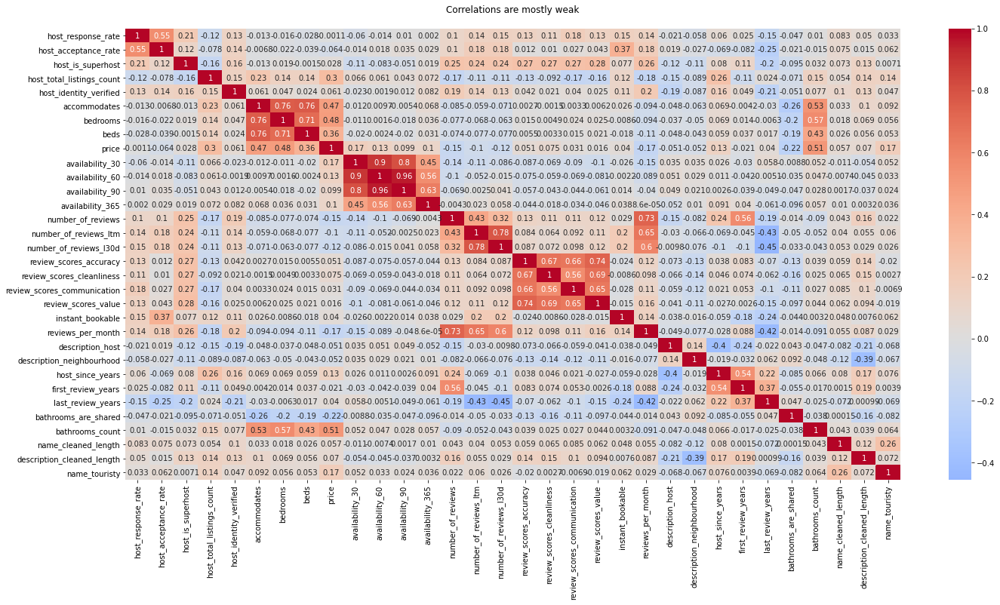

In [21]:
amenities = listings.filter(like = 'amen').columns.tolist()
to_drop = sum([amenities], ['id'])

fig, ax = plt.subplots(figsize = (23, 11))
sns.heatmap(listings.select_dtypes(exclude = 'O').drop(to_drop, 1).corr(), 
            ax = ax, cmap = 'coolwarm', center = 0, annot = True, fmt = '.2g')
plt.title('Correlations are mostly weak\n')
plt.show()

Correlations are mostly weak or moderate, but I can reduce dimensionality by dropping some. I'll check correlations above 0.8 and get rid of some features

In [22]:
def calc_rel_std(feature, data):
    return data[feature].std() / data[feature].mean()

def return_corrpair_dt(df, threshold):
    
    corr_pairs = df.corr().abs().unstack().reset_index()
    corr_pairs.rename(columns = {'level_0' : 'feature_1', 'level_1' : 'feature_2', 0 : 'correlation'}, inplace = True)
    corr_pairs = corr_pairs[corr_pairs['correlation'] != 1].sort_values('correlation', ascending = False)

    above_threshold = corr_pairs[corr_pairs['correlation'] > threshold].groupby('correlation').head(1).reset_index(drop = True)

    above_threshold['feature_1_relstd'] = above_threshold['feature_1'].apply(lambda x: calc_rel_std(x, df))
    above_threshold['feature_2_relstd'] = above_threshold['feature_2'].apply(lambda x: calc_rel_std(x, df))
    
    above_threshold['drop'] = above_threshold[['feature_1_relstd', 'feature_2_relstd']].idxmax(axis=1)
    
    change_to = {'feature_2_relstd' : 'feature_1', 'feature_1_relstd' : 'feature_2'}
    above_threshold.replace({'drop' : change_to}, inplace = True)
    
    above_threshold['drop'] = above_threshold.lookup(above_threshold.index, above_threshold['drop'])

    return above_threshold, above_threshold['drop'].value_counts()

In [25]:
corr_pair_check = return_corrpair_dt(listings.select_dtypes(exclude = 'O').drop(to_drop, 1), .8)
corr_pair_check[0]

,feature_1,feature_2,correlation,feature_1_relstd,feature_2_relstd,drop
0,availability_90,availability_60,0.958928,0.650674,0.740113,availability_90
1,availability_30,availability_60,0.896477,0.968282,0.740113,availability_60
2,availability_90,availability_30,0.802125,0.650674,0.968282,availability_90


In [26]:
listings.drop(corr_pair_check[1].index, 1, inplace = True)

### Co-distribution among features

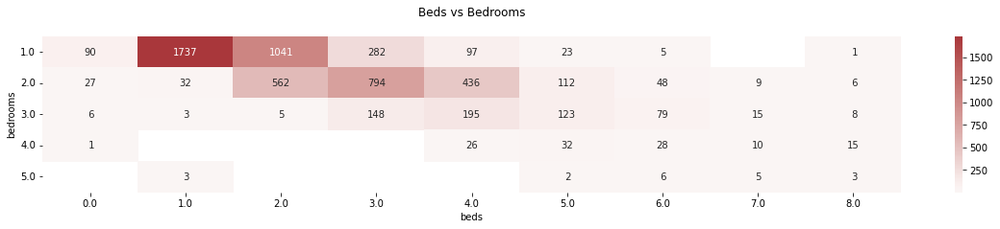

In [27]:
fig, ax = plt.subplots(figsize = (20, 3))
sns.heatmap(listings.pivot_table(index = 'bedrooms', columns = 'beds', values = 'id', aggfunc = 'count'), 
            ax = ax, cmap = 'vlag', center = 0, annot = True, fmt = '2g')
plt.title('Beds vs Bedrooms\n')
plt.yticks(va = 'center', rotation = 0)
plt.show()

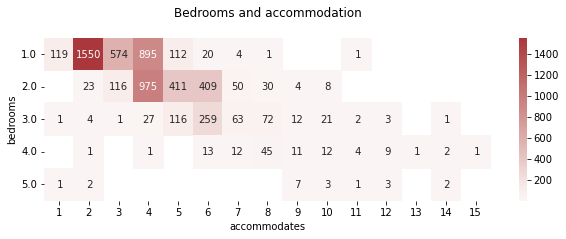

In [28]:
fig, ax = plt.subplots(figsize = (10, 3))
sns.heatmap(listings.pivot_table(index = 'bedrooms', columns = 'accommodates', values = 'id', aggfunc = 'count'), 
            ax = ax, cmap = 'vlag', center = 0, annot = True, fmt = '2g') # cmap = 'bwr'
plt.title('Bedrooms and accommodation\n')
plt.yticks(va = 'center', rotation = 0)
plt.show()

In [29]:
### drop weird datapoints

print(listings.shape)

listings = listings[~((listings['bedrooms'] == 1) & (listings['beds'] >= 6))]
listings = listings[~((listings['bedrooms'] == 1) & (listings['accommodates'] >= 7))]
listings = listings[~((listings['bedrooms'] >= 4) & (listings['accommodates'] <= 6))]

print(listings.shape)

(6015, 53)
(5986, 53)


In [31]:
fig = px.box(listings, y = 'host_response_time', x = 'review_scores_value', 
             title = 'Ratings with respect to hosts response time', 
             width = 950, height = 450)
fig.update_layout(showlegend = True, boxgap = 0.25, boxgroupgap = .1)
fig.update_yaxes(visible = True, showticklabels = True, title = None)
fig.update_traces(marker= {'size' : 3}, line = {'width' : 1})
fig.show()

Calculate co-occurence of amenities - relative to row count

In [33]:
amenities = listings.filter(like = 'amen').columns.tolist()
amenity_co_occurence = listings[amenities].T.dot(listings[amenities]) / listings.shape[0]
np.fill_diagonal(amenity_co_occurence.values, 0)

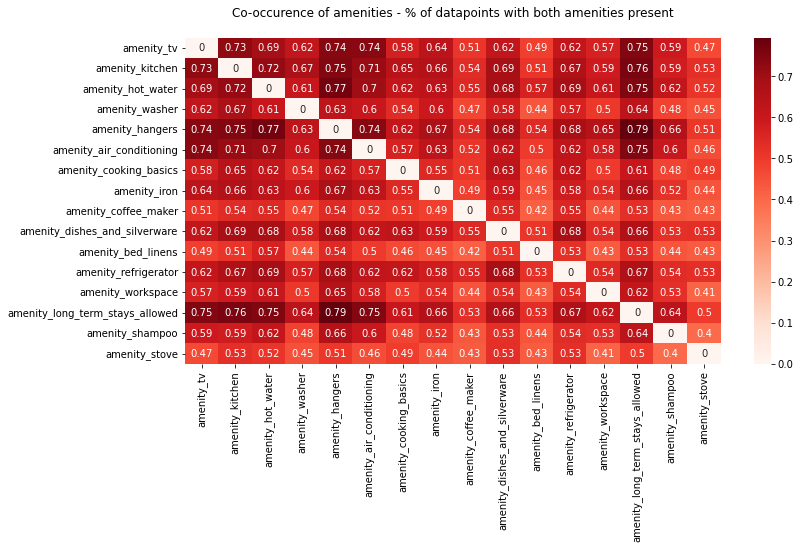

In [34]:
fig, ax = plt.subplots(figsize = (12, 6))
sns.heatmap(amenity_co_occurence, 
            ax = ax, cmap = 'Reds', annot = True, fmt = '.2g') # cmap = 'bwr'
plt.title('Co-occurence of amenities - % of datapoints with both amenities present\n')
plt.yticks(va = 'center', rotation = 0)
plt.show()

True/False features and price distribution

In [101]:
cols = listings.filter(like = 'amen').columns.tolist()
other_true_false_cols = ['host_is_superhost', 'host_identity_verified', 'instant_bookable', 'description_host', 
'description_neighbourhood', 'bathrooms_are_shared', 'name_touristy']
cols.extend(other_true_false_cols)
tf_cols = cols.copy()

cols.append('price')

amen_melted = listings[cols].melt(value_vars = tf_cols, id_vars = 'price')
amen_melted.columns = ['price', 'c', 'value']
amen_melted['value'] = amen_melted['value'].astype('O')

fig = px.box(amen_melted, facet_col = 'c', facet_col_wrap = 4, facet_row_spacing = 0.04, facet_col_spacing=0.04,
             y = 'price', x = 'value', boxmode = 'overlay', range_y = [0, 300],
             width = 950, height = 950)


fig.update_xaxes(visible = True, showticklabels = True, title = None)
fig.for_each_annotation(lambda a: a.update(text = a.text.split('=')[-1]))
fig.update_traces(marker= {'size' : 3}, line = {'width' : 1})
fig.show()

#fig.update_xaxes(matches = None)
#fig.update_layout(showlegend = True, boxgap = 0.25, boxgroupgap = .1)

## 3. Get ready for modeling

In [105]:
listings.drop(['id', 'listing_url', 'name', 'description'], 1, inplace = True)

Delete datapoints where any of the score ratings is 0 (how is it even possible) or 1 (1 bad review & nothing else)

In [109]:
print(listings.shape)

to_drop_indices = listings.filter(like = 'score')[listings.filter(like = 'score').isin([0, 1]).any(axis = 1)].index
listings.drop(to_drop_indices, 0, inplace = True)

print(listings.shape)

(5986, 49)
(5966, 49)


Amenity-related columns ratio

In [110]:
amenity_col_count = listings.filter(like = 'amen').shape[1]
col_count = listings.shape[1]
amen_col_ratio = amenity_col_count / col_count

print('Out of', col_count, 'columns', amenity_col_count, 'are amenity-related')
print("That's", round(amen_col_ratio * 100, 2), '%')

Out of 49 columns 16 are amenity-related
That's 32.65 %


NaN handling TBC

In [111]:
listings.isnull().sum()[listings.isnull().sum() > 0] / listings.shape[0]

host_response_time      0.172310
host_response_rate      0.172310
host_acceptance_rate    0.170466
dtype: float64

In [112]:
listings['host_response_time'].fillna('missing', inplace = True)

In [113]:
listings.dtypes.value_counts()

int64      31
float64    15
object      3
dtype: int64

In [114]:
listings.to_csv('data/listings_modeling.csv', index = False)

In [ ]:
# fig = px.imshow(amenity_co_occurence, 
#                 title = 'Ratings with respect to hosts response time', 
#                 width = 950, height = 450, color_continuous_scale = 'bluered', )
# fig.update_layout(showlegend = False)
# fig.update_traces(showscale = False)
# fig.update_coloraxes(showscale = False)
# fig.update_xaxes(side = 'top', tickangle = 0)
# fig.show()